In [1]:
%pylab inline
import seaborn as sns

Populating the interactive namespace from numpy and matplotlib


In [2]:
import pandas as pd

# Playground - iris dataset

https://en.wikipedia.org/wiki/Iris_flower_data_set

In [3]:
from sklearn.datasets import load_iris

In [4]:
dataset=load_iris()

In [5]:
type(dataset)

sklearn.utils.Bunch

In [6]:
X=dataset["data"]

In [9]:
X[0]

array([5.1, 3.5, 1.4, 0.2])

In [10]:
feat_names=dataset["feature_names"]

In [11]:
y=dataset["target"]

In [12]:
y[0]

0

In [13]:
feat_names

['sepal length (cm)',
 'sepal width (cm)',
 'petal length (cm)',
 'petal width (cm)']

In [14]:
df=pd.DataFrame(X,columns=feat_names)

In [15]:
df

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm)
0,5.1,3.5,1.4,0.2
1,4.9,3.0,1.4,0.2
2,4.7,3.2,1.3,0.2
3,4.6,3.1,1.5,0.2
4,5.0,3.6,1.4,0.2
5,5.4,3.9,1.7,0.4
6,4.6,3.4,1.4,0.3
7,5.0,3.4,1.5,0.2
8,4.4,2.9,1.4,0.2
9,4.9,3.1,1.5,0.1


In [16]:
df["target"]=y

In [17]:
df.head()

,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,0
1,4.9,3.0,1.4,0.2,0
2,4.7,3.2,1.3,0.2,0
3,4.6,3.1,1.5,0.2,0
4,5.0,3.6,1.4,0.2,0


In [18]:
df["target"].unique()

array([0, 1, 2], dtype=int64)

In [19]:
df.shape

(150, 5)

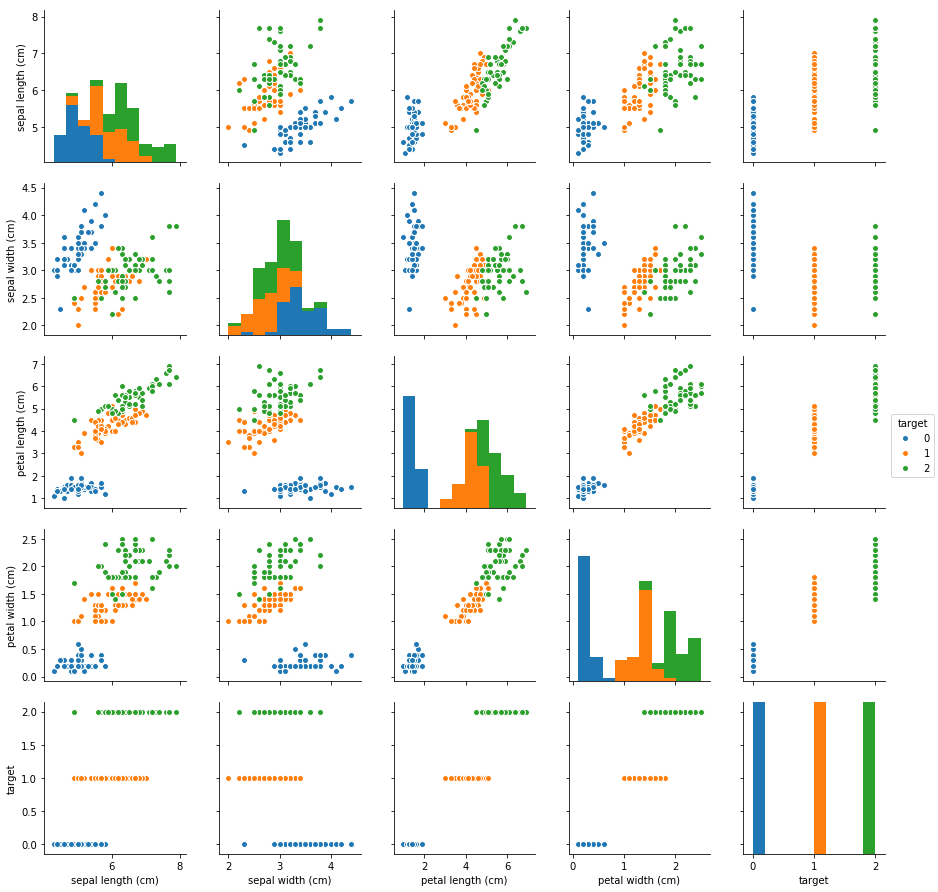

In [20]:
sns.pairplot(df,hue="target")

# Dimensionality reduction

In [21]:
from sklearn.decomposition import PCA, KernelPCA,IncrementalPCA,NMF,TruncatedSVD

In [22]:
from sklearn.manifold import TSNE

PCA (KernelPCA)

NMF

SVD (TruncatedSV)

t-SNE

UMAP

In [23]:
def plot_clustering_2D(clustering_algo):
    out=clustering_algo.fit_transform(X)
    plt.scatter(out[:,0],out[:,1], c=y)
    plt.show()

In [24]:
pca=PCA(n_components=4)

In [25]:
X.shape

(150, 4)

In [26]:
out=pca.fit_transform(X)

In [27]:
out.shape

(150, 4)

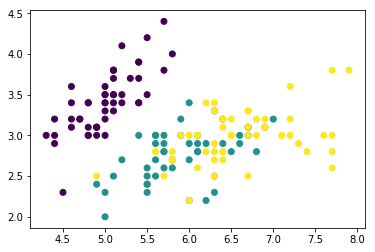

In [28]:
plt.scatter(X[:,0],X[:,1], c=y)

In [29]:
pca.explained_variance_ratio_

array([0.92461621, 0.05301557, 0.01718514, 0.00518309])

In [30]:
np.sum(pca.explained_variance_ratio_)

1.0

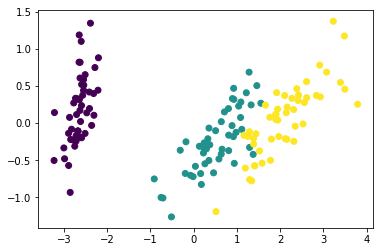

In [31]:
plt.scatter(out[:,0],out[:,1], c=y)

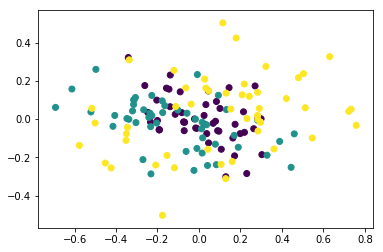

In [32]:
plt.scatter(out[:,2],out[:,3], c=y)

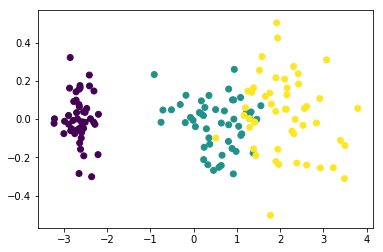

In [33]:
plt.scatter(out[:,0],out[:,3], c=y)

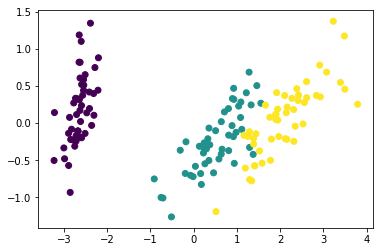

In [34]:
plot_clustering_2D(PCA(n_components=2))

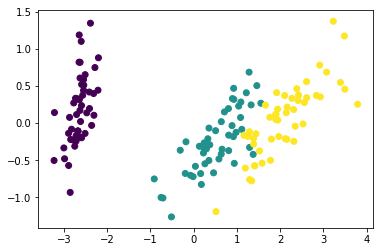

In [35]:
plot_clustering_2D(KernelPCA(n_components=2,kernel="linear"))

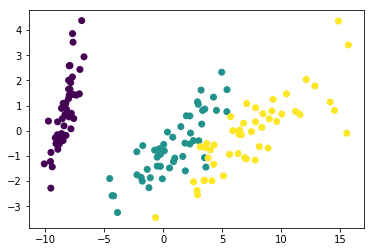

In [36]:
plot_clustering_2D(KernelPCA(n_components=2,kernel="poly",degree=2))

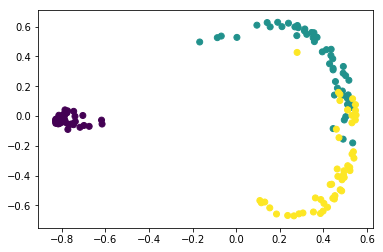

In [37]:
plot_clustering_2D(KernelPCA(n_components=2,kernel="rbf"))

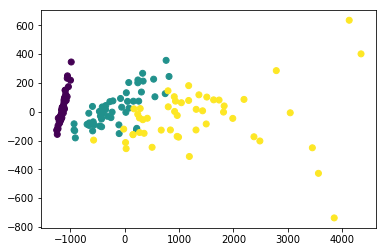

In [38]:
plot_clustering_2D(KernelPCA(n_components=2,kernel="poly",degree=5))

In [39]:
nmf = NMF(n_components=4)

In [40]:
nmf.fit(X)

NMF(alpha=0.0, beta_loss='frobenius', init=None, l1_ratio=0.0, max_iter=200,
  n_components=4, random_state=None, shuffle=False, solver='cd',
  tol=0.0001, verbose=0)

In [41]:
nmf.components_.shape

(4, 4)

In [42]:
X_trans=nmf.transform(X)

In [43]:
X_trans.shape

(150, 4)

In [44]:
nmf.reconstruction_err_

0.21212663587137323

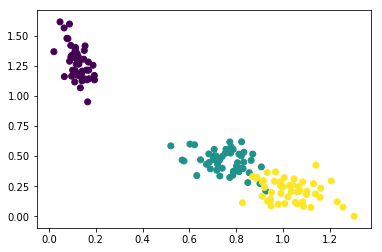

In [45]:
plot_clustering_2D(NMF(n_components=2))

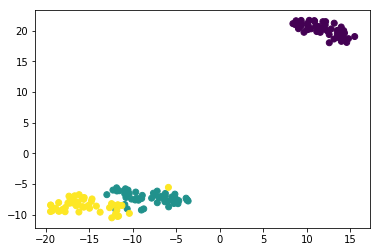

In [46]:
plot_clustering_2D(TSNE(n_components=2,random_state=16))

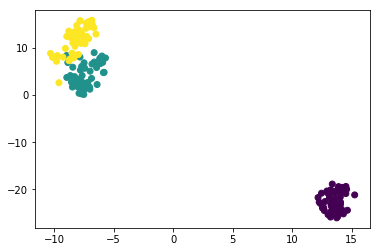

In [47]:
plot_clustering_2D(TSNE(n_components=2,random_state=1,perplexity=30))

In [48]:
df.drop("target",axis=1).to_csv("test.csv",index=None)

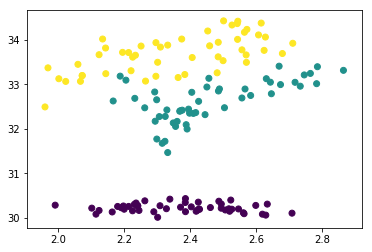

In [49]:
plot_clustering_2D(TSNE(n_components=2,random_state=1,perplexity=100))

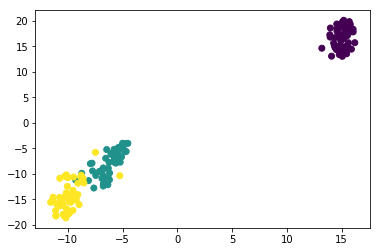

In [50]:
plot_clustering_2D(TSNE(n_components=2,random_state=10284646))

# Clustering

In [52]:
from sklearn.metrics import homogeneity_score

## KMeans

In [53]:
from sklearn.cluster import KMeans

In [54]:
kmeans=KMeans(n_clusters=4, random_state=1)

In [55]:
y_pred = kmeans.fit_predict(X)

In [56]:
y_pred

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 2, 1, 2, 1, 2, 1, 2, 2, 2, 2, 1, 2, 1,
       1, 2, 1, 2, 1, 2, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 1, 2, 1, 1, 1,
       2, 2, 2, 1, 2, 2, 2, 2, 2, 1, 2, 2, 3, 1, 3, 3, 3, 3, 2, 3, 3, 3,
       1, 1, 3, 1, 1, 3, 3, 3, 3, 1, 3, 1, 3, 1, 3, 3, 1, 1, 3, 3, 3, 3,
       3, 1, 1, 3, 3, 3, 1, 3, 3, 3, 1, 3, 3, 3, 1, 1, 3, 1])

In [57]:
kmeans.inertia_

57.345409315718165

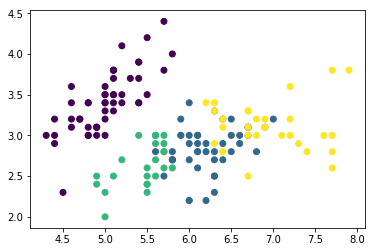

In [58]:
plt.scatter(X[:,0],X[:,1], c=y_pred)

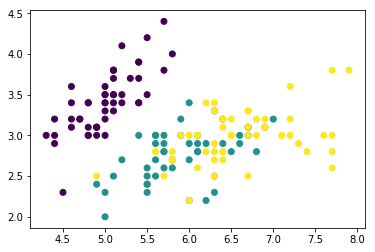

In [59]:
plt.scatter(X[:,0],X[:,1], c=y)

elbow method for cluster count determination

In [60]:
inertias=[]
scores=[]
n_clusters=list(range(1,10))
for n_cluster in n_clusters:
    kmeans=KMeans(n_clusters=n_cluster)
    y_pred=kmeans.fit_predict(X)
    scores.append(homogeneity_score(y,y_pred))
    inertias.append(kmeans.inertia_)

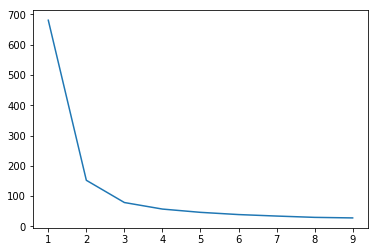

In [61]:
plt.plot(n_clusters,inertias)

we are "cheating" here, because compare it to known answers (target)

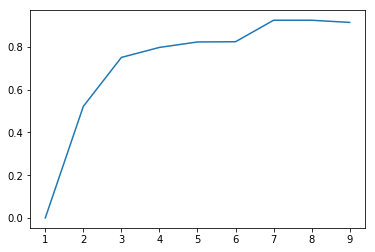

In [62]:
plt.plot(n_clusters,scores)

## Density based algorithm (DBSCAN)

In [63]:
from sklearn.cluster import DBSCAN

In [64]:
DBSCAN()

DBSCAN(algorithm='auto', eps=0.5, leaf_size=30, metric='euclidean',
    metric_params=None, min_samples=5, n_jobs=1, p=None)

In [65]:
db_scores=[]
epss=np.linspace(0.01,1)
for eps in epss:
    dbscan=DBSCAN(eps=eps)
    y_pred=dbscan.fit_predict(X)
    db_scores.append(homogeneity_score(y,y_pred))


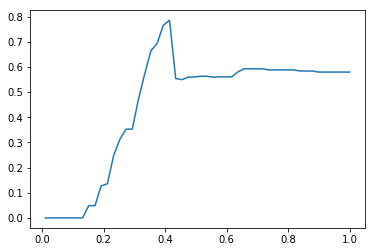

In [66]:
plt.plot(epss,db_scores)

In [67]:
dbscan=DBSCAN(eps=0.4)
y_pred=dbscan.fit_predict(X)

In [68]:
y_pred

array([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, -1, -1,  0,
        0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
        0,  0,  0,  0,  0,  0,  0, -1,  0,  0,  0,  0,  0,  0,  0,  0,  1,
        1,  1,  1,  1,  1,  1, -1,  1,  1, -1,  1, -1,  1, -1,  1,  1,  1,
       -1,  1,  2,  1,  2,  1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  2, -1,
       -1,  1, -1,  1,  1,  1,  1,  1, -1,  1,  1,  1,  1, -1,  1, -1,  2,
        3,  3,  3, -1, -1, -1, -1, -1,  3,  3,  3,  2, -1,  3,  3, -1, -1,
       -1,  3,  2, -1,  2,  3, -1,  2,  2,  3, -1, -1, -1,  3,  2, -1, -1,
        3,  3,  2,  3,  3,  3,  2,  3,  3,  3,  2,  3,  3,  2],
      dtype=int64)

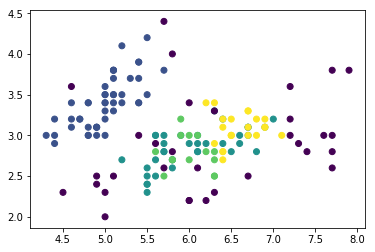

In [69]:
plt.scatter(X[:,0],X[:,1], c=y_pred)

## Gaussian mixture

http://scikit-learn.org/stable/modules/mixture.html

In [70]:
from sklearn.mixture import GaussianMixture

In [71]:
gm_scores=[]
aics=[]
bics=[]
n_clusters=list(range(1,10))
for n_cluster in n_clusters:
    gm = GaussianMixture(n_components=n_cluster,verbose=0)
    gm.fit(X)
    y_pred=gm.predict(X)
    gm_scores.append(homogeneity_score(y,y_pred))
    aics.append(gm.aic(X))
    bics.append(gm.bic(X))

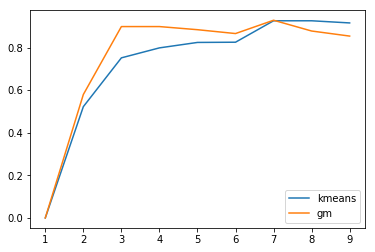

In [72]:
plt.plot(n_clusters,scores,label="kmeans")
plt.plot(n_clusters,gm_scores,label="gm")
plt.legend()

Two information criteria:

AIC - https://en.wikipedia.org/wiki/Akaike_information_criterion

BIC - https://en.wikipedia.org/wiki/Bayesian_information_criterion


Lower values are preferred

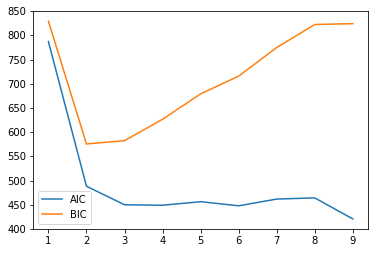

In [73]:
plt.plot(n_clusters,aics,label="AIC")
plt.plot(n_clusters,bics,label="BIC")
plt.legend()

Can be used for selection of number of clusters
http://scikit-learn.org/stable/auto_examples/mixture/plot_gmm_selection.html

In [74]:
gm = GaussianMixture(n_components=3,verbose=0)
gm.fit(X)
y_pred=gm.predict(X)

In [75]:
homogeneity_score(y,y_pred)

0.8983263672602775

visualize the center of Gaussians

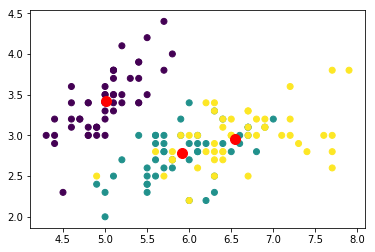

In [76]:
plt.scatter(X[:,0],X[:,1],c=y)
plt.scatter(gm.means_[:,0],gm.means_[:,1],marker="o",color="r",s=100)

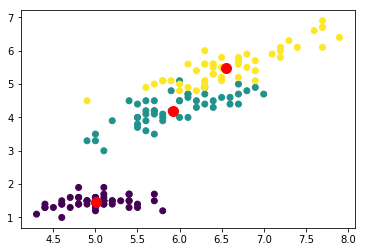

In [77]:
plt.scatter(X[:,0],X[:,2],c=y)
plt.scatter(gm.means_[:,0],gm.means_[:,2],marker="o",color="r",s=100)

In [78]:
pca.

SyntaxError: invalid syntax (<ipython-input-78-66bde7451cab>, line 1)

# Overview of clustering methods in sklearn

http://scikit-learn.org/stable/modules/clustering.html

TODO: try different clustering algorithm by yourself and compare its homogeneity_score

#  Materials Project data

Results of DFT simulations, extracted from the Materials Project (https://materialsproject.org/)

In [79]:
df=pd.read_csv("materials_project_data.csv")

In [100]:
df.shape

(7321, 106)

In [80]:
df.head()

,structure_id,COMPOSITION,NUMBER_OF_ATOMS,e_above_hull,band_gap,total_magnetization,formation_energy_per_atom,density,magnetization_per_atom,nuH,...,Tl,Tm,U,V,W,Xe,Y,Yb,Zn,Zr
0,304742,Fe-2 N-6 Sr-6,14,0.000000,0.0000,4.160592e+00,-0.817217,4.448535,2.971851e-01,0.260710,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,311952,Pt-21 Ti-7,28,0.000000,0.0000,1.482900e-03,-0.859812,17.027462,5.296071e-05,0.302075,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,305877,Ga-2 In-2 Te-4,8,0.038644,0.0000,8.710000e-05,-0.295817,5.831028,1.088750e-05,0.252565,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,306089,As-2 Ba-1 Co-2,5,0.000000,0.0009,-9.967188e-01,-0.611376,6.678675,1.993438e-01,0.288910,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,305559,Ca-2 O-6 Pt-2,10,0.010892,1.2796,9.000000e-07,-2.000892,7.918129,9.000000e-08,0.299680,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [102]:
for i in df.columns:
    print(i)

structure_id
COMPOSITION
NUMBER_OF_ATOMS
e_above_hull
band_gap
total_magnetization
formation_energy_per_atom
density
magnetization_per_atom
nuH
GH
EH
AVR
BH
comp_dict
norm_comp_dict
elements
Ac
Ag
Al
Ar
As
Au
B
Ba
Be
Bi
Br
C
Ca
Cd
Ce
Cl
Co
Cr
Cs
Cu
Dy
Er
Eu
F
Fe
Ga
Gd
Ge
H
He
Hf
Hg
Ho
I
In
Ir
K
Kr
La
Li
Lu
Mg
Mn
Mo
N
Na
Nb
Nd
Ne
Ni
Np
O
Os
P
Pa
Pb
Pd
Pm
Pr
Pt
Pu
Rb
Re
Rh
Ru
S
Sb
Sc
Se
Si
Sm
Sn
Sr
Ta
Tb
Tc
Te
Th
Ti
Tl
Tm
U
V
W
Xe
Y
Yb
Zn
Zr


In [81]:
elements=['Ac', 'Ag', 'Al', 'Ar', 'As', 'Au', 'B', 'Ba', 'Be', 'Bi', 'Br', 'C', 'Ca', 'Cd', 'Ce', 'Cl', 'Co', 'Cr', 'Cs', 'Cu', 'Dy', 'Er', 'Eu', 'F', 'Fe', 'Ga', 'Gd', 'Ge', 'H',
 'He', 'Hf', 'Hg', 'Ho', 'I', 'In', 'Ir', 'K', 'Kr', 'La', 'Li', 'Lu', 'Mg', 'Mn', 'Mo', 'N', 'Na', 'Nb', 'Nd', 'Ne', 'Ni', 'Np', 'O', 'Os', 'P', 'Pa', 'Pb', 'Pd', 'Pm', 'Pr', 'Pt', 'Pu', 'Rb', 'Re', 'Rh',
 'Ru', 'S', 'Sb', 'Sc', 'Se', 'Si', 'Sm', 'Sn', 'Sr', 'Ta', 'Tb', 'Tc', 'Te', 'Th', 'Ti', 'Tl', 'Tm', 'U', 'V', 'W', 'Xe', 'Y', 'Yb', 'Zn', 'Zr']

In [104]:
prop_columns=["band_gap","magnetization_per_atom","BH","GH","EH"]

In [107]:
X = df[elements]

In [108]:
X

,Ac,Ag,Al,Ar,As,Au,B,Ba,Be,Bi,...,Tl,Tm,U,V,W,Xe,Y,Yb,Zn,Zr
0,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
1,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
2,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
3,0.0,0.000000,0.000000,0.0,0.400000,0.00,0.0,0.200000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
4,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
5,0.0,0.000000,0.000000,0.0,0.333333,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
6,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.166667,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
7,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.333333,0.0,0.00,0.333333
8,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000
9,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.00,0.000000


TODO:

1. dimensionality reduction into 2 dimensions with t-SNE:

In [106]:
from sklearn.manifold import TSNE

In [85]:
tsne = TSNE(n_components=2, random_state=42, init="pca", verbose=2, n_iter=500, learning_rate=100., perplexity=100., n_iter_without_progress=50)

In [86]:
X_tr_tsne=tsne.fit_transform(X)

[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 7321 samples in 0.195s...
[t-SNE] Computed neighbors for 7321 samples in 8.880s...
[t-SNE] Computed conditional probabilities for sample 1000 / 7321
[t-SNE] Computed conditional probabilities for sample 2000 / 7321
[t-SNE] Computed conditional probabilities for sample 3000 / 7321
[t-SNE] Computed conditional probabilities for sample 4000 / 7321
[t-SNE] Computed conditional probabilities for sample 5000 / 7321
[t-SNE] Computed conditional probabilities for sample 6000 / 7321
[t-SNE] Computed conditional probabilities for sample 7000 / 7321
[t-SNE] Computed conditional probabilities for sample 7321 / 7321
[t-SNE] Mean sigma: 0.233290
[t-SNE] Computed conditional probabilities in 1.064s
[t-SNE] Iteration 50: error = 74.9274826, gradient norm = 0.0008087 (50 iterations in 20.968s)
[t-SNE] Iteration 100: error = 74.6346436, gradient norm = 0.0003547 (50 iterations in 20.584s)
[t-SNE] Iteration 150: error = 74.6026230, gradient norm 

In [92]:
X_tr_tsne.shape

(7321, 2)

2. visualize dataset in 2D

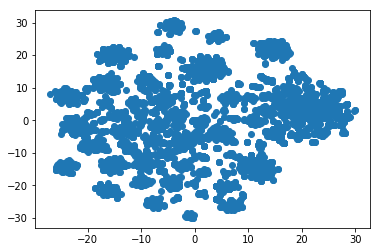

In [93]:
plt.scatter(X_tr_tsne[:,0], X_tr_tsne[:,1])

3. clustering with DBSCAN() on the 2D representation from the p.1

In [109]:
cluster = DBSCAN()
labels=cluster.fit_predict(X_tr_tsne)

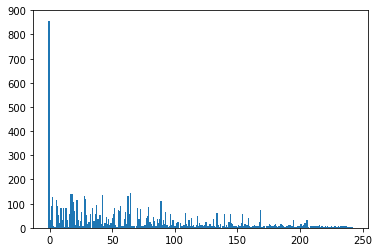

In [121]:
plt.hist(labels,250)
plt.show()

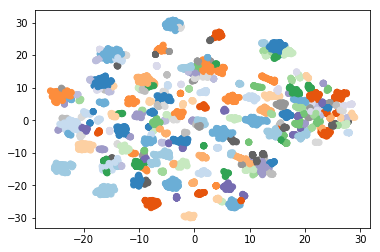

In [135]:
plt.scatter(X_tr_tsne[mask,0], X_tr_tsne[mask,1], c=labels[mask], cmap="tab20c")
plt.colorbar()

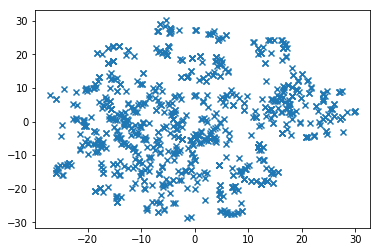

In [136]:
plt.scatter(X_tr_tsne[~mask,0], X_tr_tsne[~mask,1], marker="x")

Number of clusters found: 244
Fraction of classified objects: 0.8829394891408278


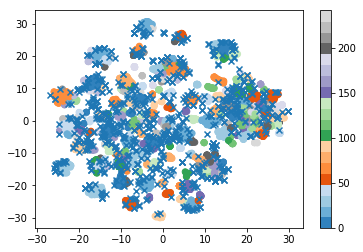

In [95]:
print("Number of clusters found:", len(set(labels)))
# label=-1 corresponds to unclassified object
mask=labels>=0
print("Fraction of classified objects:",np.mean(mask))

plt.scatter(X_tr_tsne[mask,0], X_tr_tsne[mask,1], c=labels[mask], cmap="tab20c")
plt.colorbar()
plt.scatter(X_tr_tsne[~mask,0], X_tr_tsne[~mask,1], marker="x")

**<h1>TODO</h1>** Try different values of the inter-objects distances (eps) and number of minimum samples in a cluster (min_samples) to have a "reasonable" clustering

In [137]:
cluster = DBSCAN(eps=0.5, min_samples=30)

Number of clusters found: 58
Fraction of classified objects: 0.3436688976915722


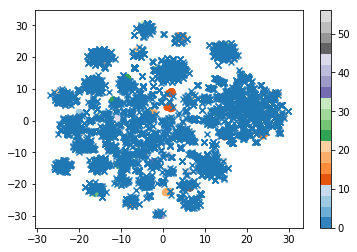

In [138]:
labels=cluster.fit_predict(X_tr_tsne)
print("Number of clusters found:", len(set(labels)))
# label=-1 corresponds to unclassified object
mask=labels>=0
print("Fraction of classified objects:",np.mean(mask))

plt.scatter(X_tr_tsne[mask,0], X_tr_tsne[mask,1], c=labels[mask], cmap="tab20c")
plt.colorbar()
plt.scatter(X_tr_tsne[~mask,0], X_tr_tsne[~mask,1], marker="x")

here is a visualizetion to highlight each cluster on a separate plot

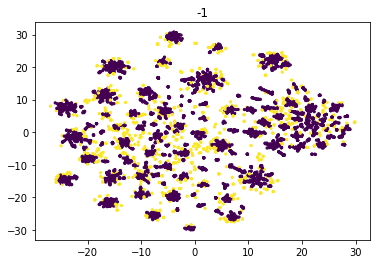

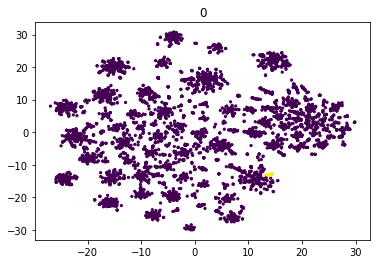

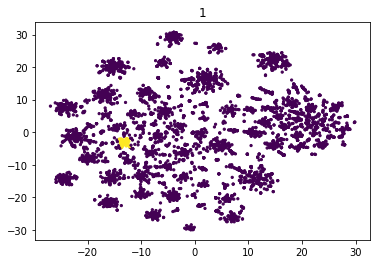

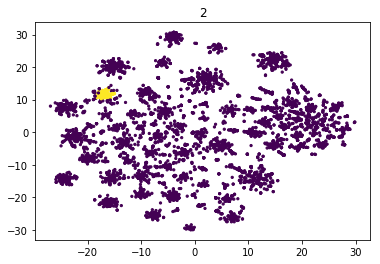

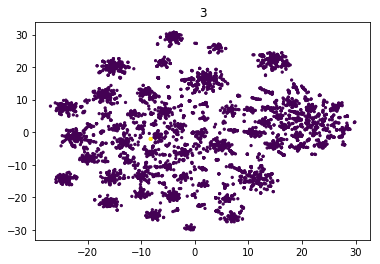

...

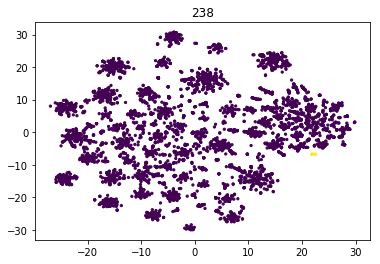

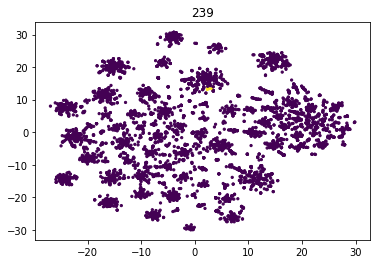

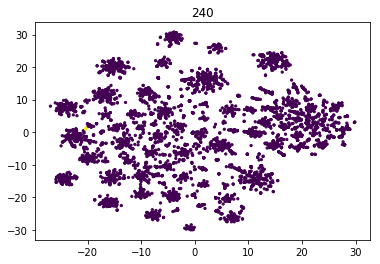

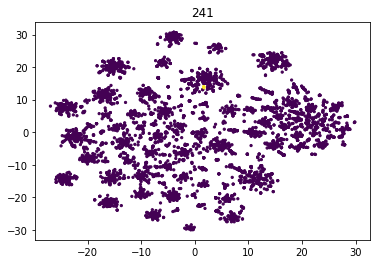

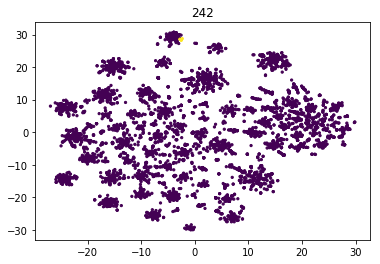

In [98]:
for lab in np.unique(labels):
    label_mask = labels==lab
    plt.scatter(X_tr_tsne[:,0], X_tr_tsne[:,1], c=label_mask, s=5)
    plt.title(lab)
    plt.show()

here is a visualizetion to highlight each element concentration on a separate plot

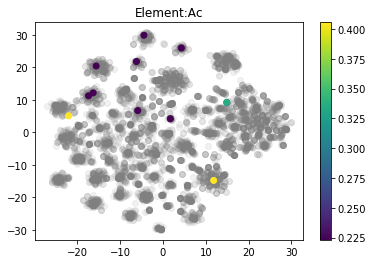

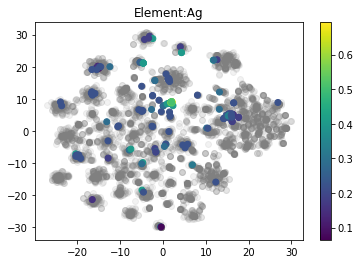

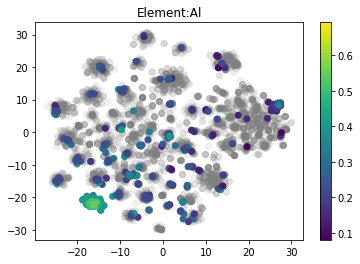

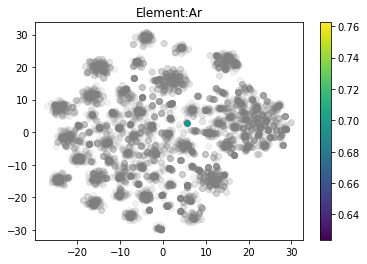

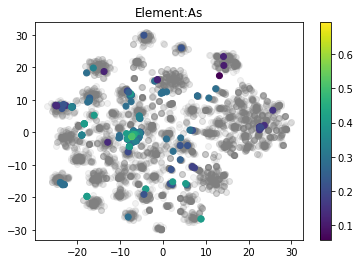

...

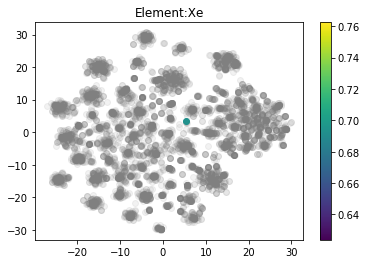

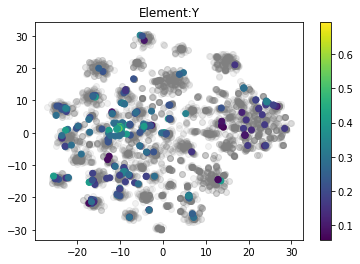

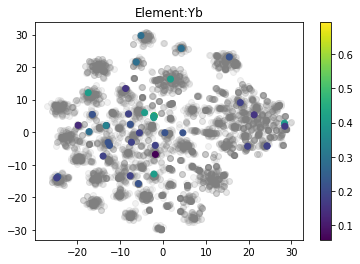

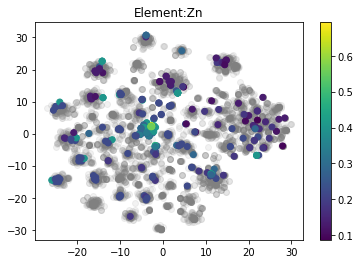

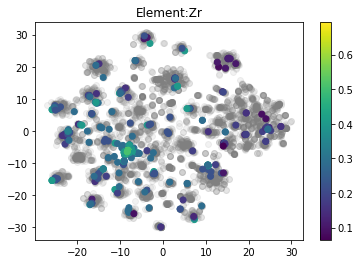

In [99]:
for p in elements:
    element_mask = df[p]>0
    plt.scatter(X_tr_tsne[~element_mask,0], X_tr_tsne[~element_mask,1],alpha=0.1,color="gray")
    plt.scatter(X_tr_tsne[element_mask,0], X_tr_tsne[element_mask,1],c=np.log1p(df.loc[element_mask,p]))    
    plt.colorbar()
    plt.title("Element:"+p)
    plt.show()

In [139]:
df["labels"] =labels

In [140]:
cluster_mean_elements=df.groupby("labels")[elements].mean()
cluster_mean_elements[cluster_mean_elements<2.5e-2]=0

In [142]:
for lab in np.unique(labels):
    cluster_mean_composition=cluster_mean_elements.loc[lab]
    cluster_mean_composition=cluster_mean_composition[cluster_mean_composition>0]
    ave_comp_str=" ".join(["%s(%.3f)"%(k,v) for k, v in cluster_mean_composition.to_dict().items()])
    print(lab,":", ave_comp_str)

-1 : F(0.034) Li(0.029) N(0.035) Ni(0.025) O(0.142) S(0.037) Si(0.028) Ti(0.025)
0 : Pt(0.737)
1 : Mg(0.701) Pd(0.026)
2 : O(0.578) Sr(0.251)
3 : Fe(0.033) P(0.735)
4 : Co(0.033) Na(0.346) O(0.477)
5 : Al(0.041) Zr(0.678)
6 : Li(0.773) Mg(0.026) Sn(0.026)
7 : Al(0.037) Au(0.631) Li(0.032)
8 : Ga(0.695) Sc(0.029) Zr(0.031)
9 : C(0.047) Cr(0.027) V(0.659)
10 : Ni(0.741)
11 : B(0.750)
12 : Ag(0.645) Al(0.030) Mg(0.051) S(0.038)
13 : Ca(0.041) Cd(0.034) Hg(0.601) Li(0.045) Mg(0.026) Pm(0.026) Pt(0.026) Sr(0.026) Y(0.053)
14 : Mn(0.269) O(0.612)
15 : Br(0.674) Cs(0.042)
16 : C(0.044) Fe(0.724) N(0.040)
17 : Al(0.026) C(0.045) Os(0.029) Si(0.032) Ta(0.649)
18 : Zn(0.735)
19 : Al(0.341) O(0.590)
20 : Pd(0.747)
21 : H(0.663) Mg(0.055) N(0.026)
22 : Cs(0.050) I(0.681)
23 : Cu(0.345) O(0.507)
24 : Cu(0.752)
25 : Ir(0.030) Pd(0.030) Ru(0.037) Sn(0.707)
26 : Al(0.751)
27 : Si(0.799)
28 : Cu(0.343) S(0.496)
29 : Cl(0.655) K(0.060) Rb(0.074)
30 : F(0.822)
31 : Al(0.039) Ge(0.025) Nb(0.038) Ru(0.546)

In [143]:
fig_size=4
ncol_max=5

Cluster: -1
-1 : F(0.034) Li(0.029) N(0.035) Ni(0.025) O(0.142) S(0.037) Si(0.028) Ti(0.025)


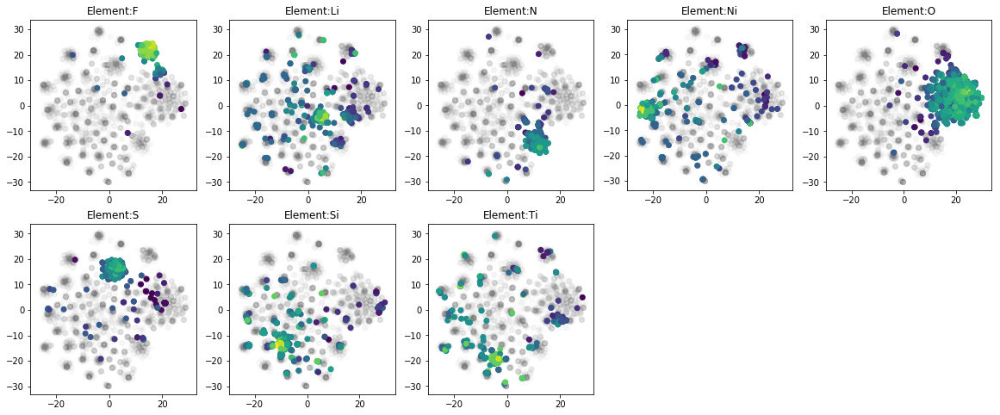

Cluster: 0
0 : Pt(0.737)


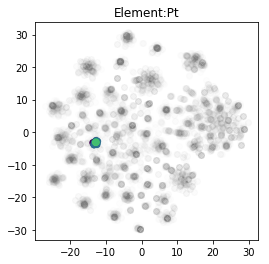

Cluster: 1
1 : Mg(0.701) Pd(0.026)


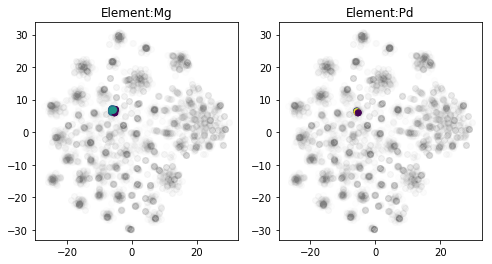

Cluster: 2
2 : O(0.578) Sr(0.251)


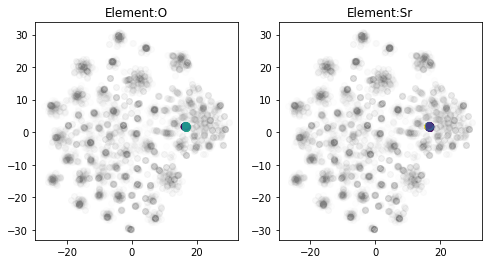

Cluster: 3
3 : Fe(0.033) P(0.735)


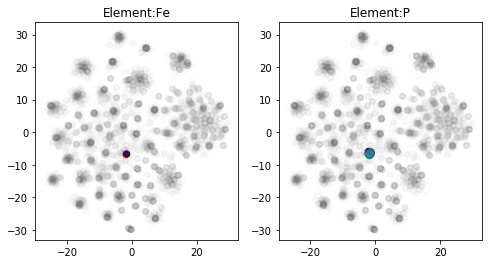

Cluster: 4
4 : Co(0.033) Na(0.346) O(0.477)


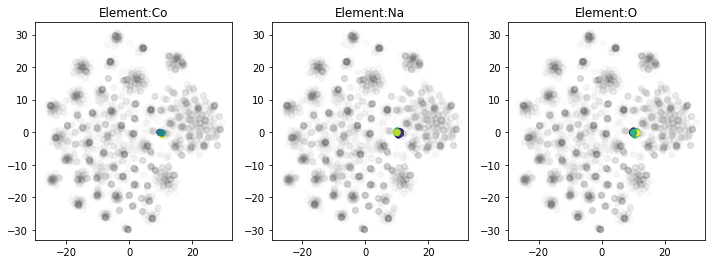

Cluster: 5
5 : Al(0.041) Zr(0.678)


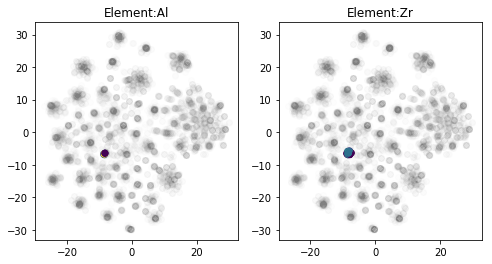

Cluster: 6
6 : Li(0.773) Mg(0.026) Sn(0.026)


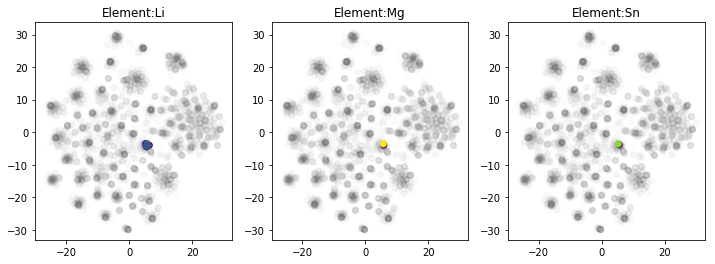

Cluster: 7
7 : Al(0.037) Au(0.631) Li(0.032)


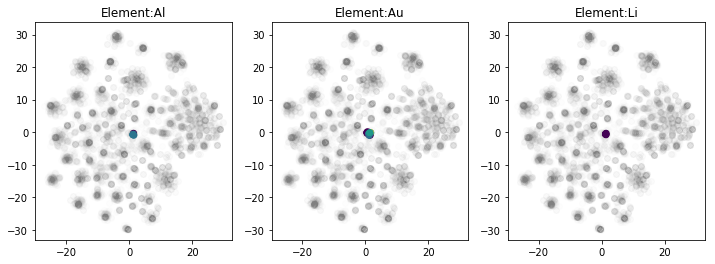

Cluster: 8
8 : Ga(0.695) Sc(0.029) Zr(0.031)


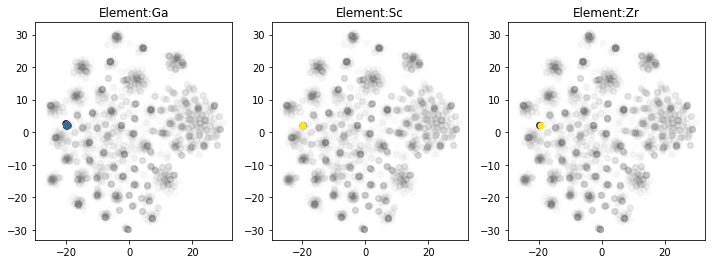

Cluster: 9
9 : C(0.047) Cr(0.027) V(0.659)


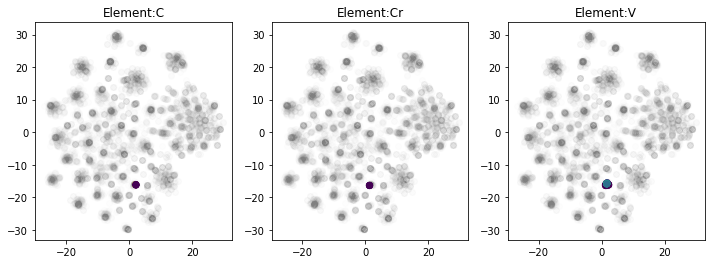

Cluster: 10
10 : Ni(0.741)


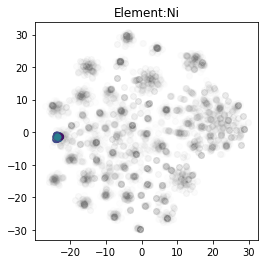

Cluster: 11
11 : B(0.750)


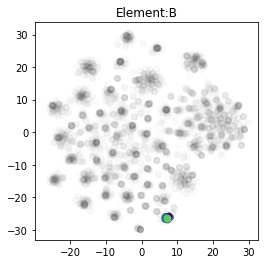

Cluster: 12
12 : Ag(0.645) Al(0.030) Mg(0.051) S(0.038)


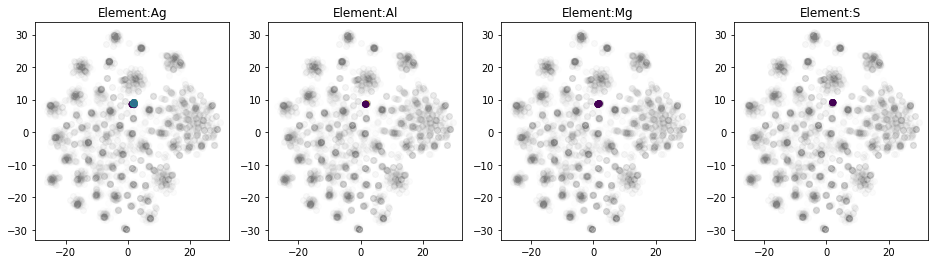

Cluster: 13
13 : Ca(0.041) Cd(0.034) Hg(0.601) Li(0.045) Mg(0.026) Pm(0.026) Pt(0.026) Sr(0.026) Y(0.053)


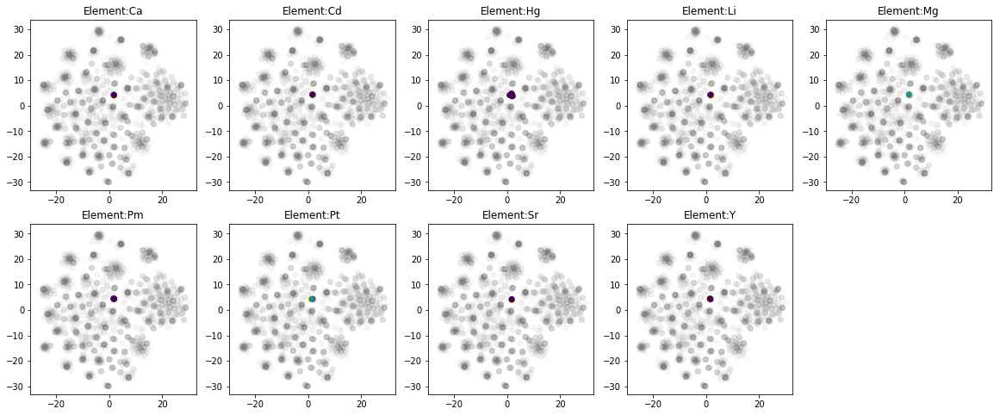

Cluster: 14
14 : Mn(0.269) O(0.612)


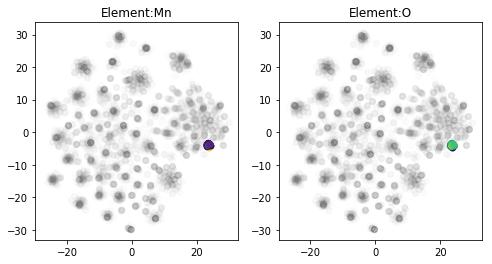

Cluster: 15
15 : Br(0.674) Cs(0.042)


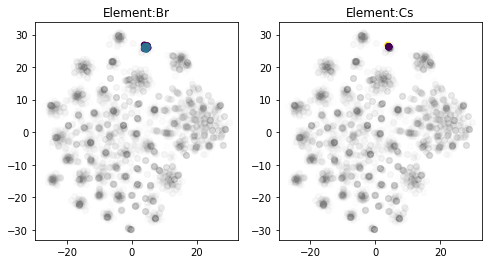

Cluster: 16
16 : C(0.044) Fe(0.724) N(0.040)


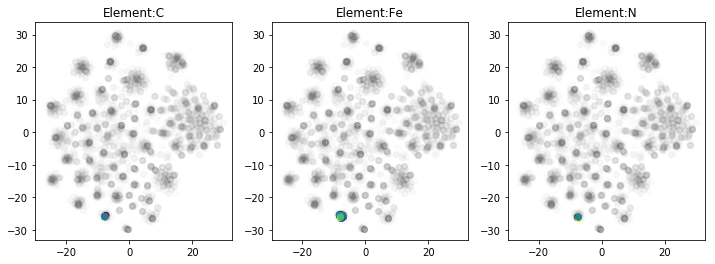

Cluster: 17
17 : Al(0.026) C(0.045) Os(0.029) Si(0.032) Ta(0.649)


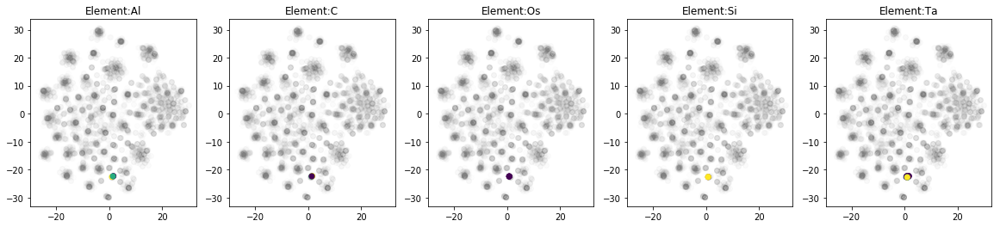

Cluster: 18
18 : Zn(0.735)


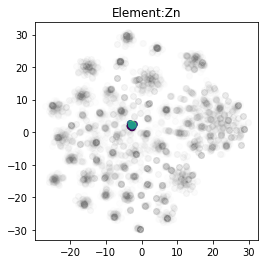

Cluster: 19
19 : Al(0.341) O(0.590)


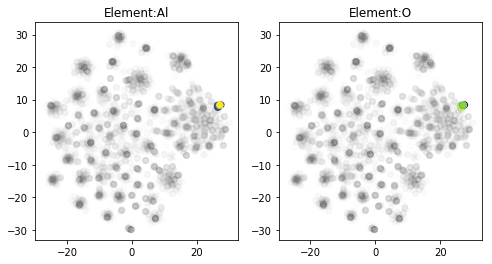

Cluster: 20
20 : Pd(0.747)


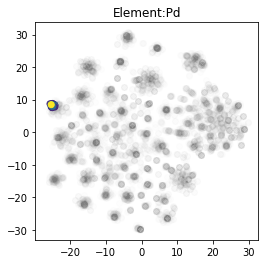

Cluster: 21
21 : H(0.663) Mg(0.055) N(0.026)


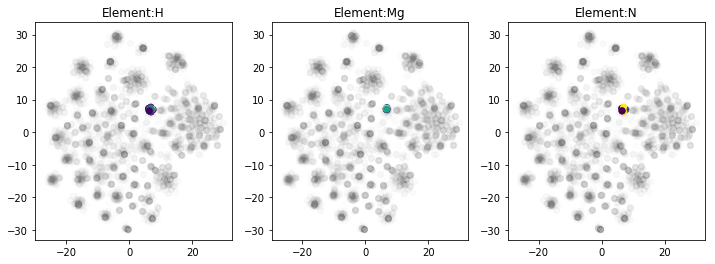

Cluster: 22
22 : Cs(0.050) I(0.681)


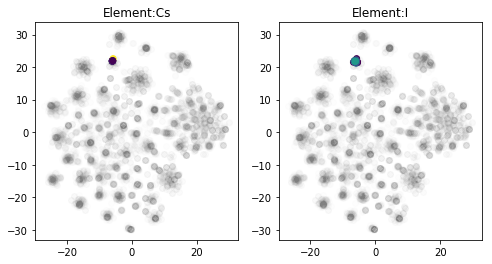

Cluster: 23
23 : Cu(0.345) O(0.507)


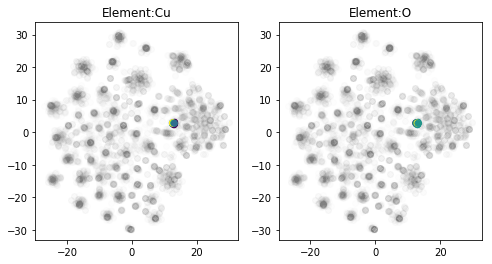

Cluster: 24
24 : Cu(0.752)


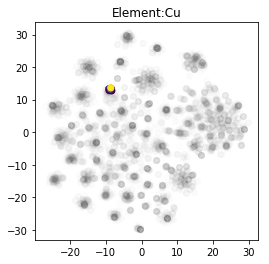

Cluster: 25
25 : Ir(0.030) Pd(0.030) Ru(0.037) Sn(0.707)


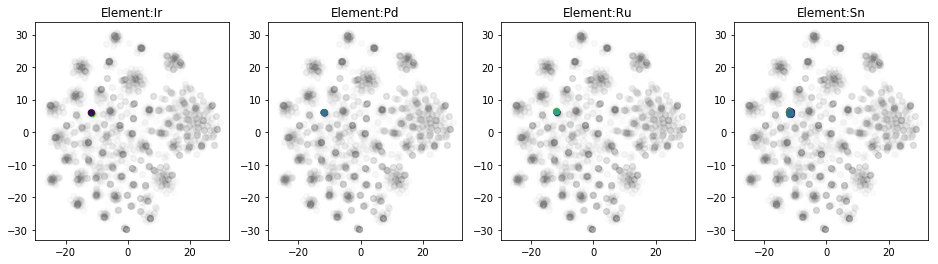

Cluster: 26
26 : Al(0.751)


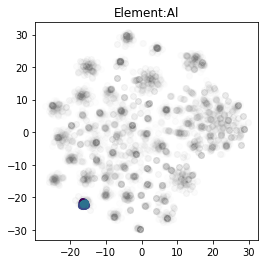

Cluster: 27
27 : Si(0.799)


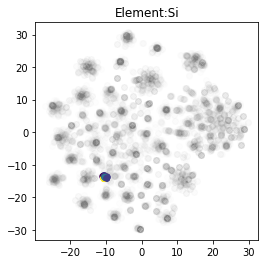

Cluster: 28
28 : Cu(0.343) S(0.496)


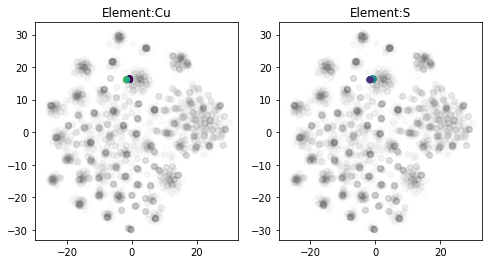

Cluster: 29
29 : Cl(0.655) K(0.060) Rb(0.074)


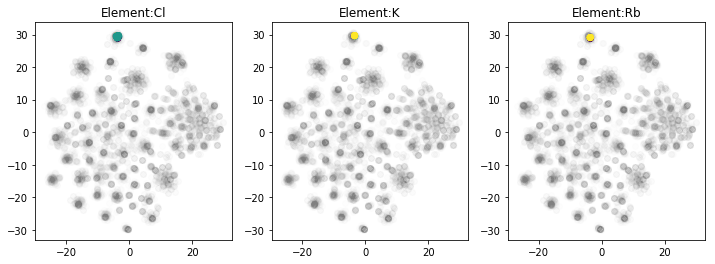

Cluster: 30
30 : F(0.822)


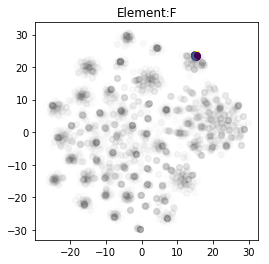

Cluster: 31
31 : Al(0.039) Ge(0.025) Nb(0.038) Ru(0.546) Sc(0.043) Ta(0.034) V(0.030)


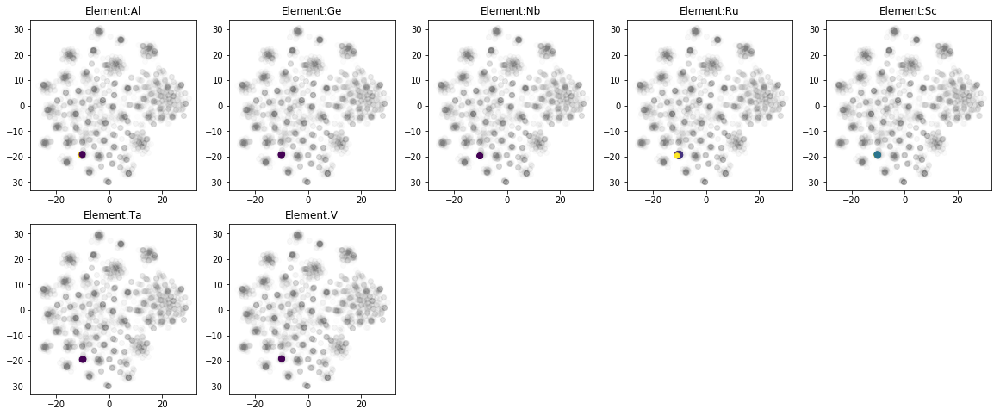

Cluster: 32
32 : Cr(0.032) Sb(0.675)


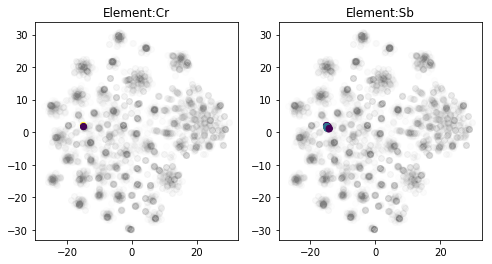

Cluster: 33
33 : Cl(0.753)


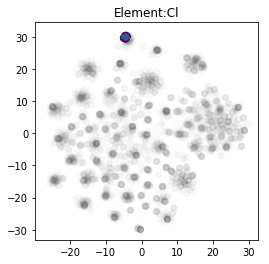

Cluster: 34
34 : Ir(0.595) Mg(0.054) Sc(0.034) Ti(0.029)


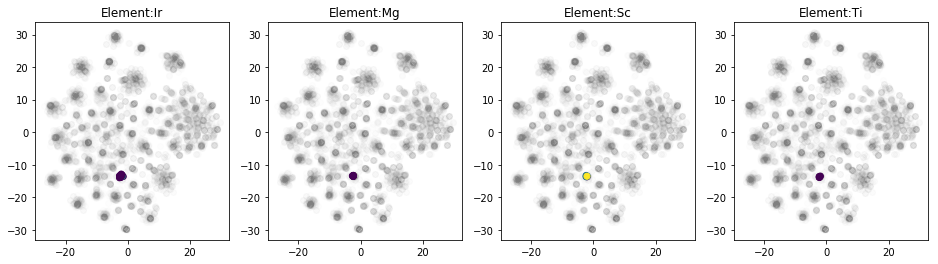

Cluster: 35
35 : Al(0.045) C(0.025) Ge(0.026) Mn(0.621) Ti(0.036) V(0.026)


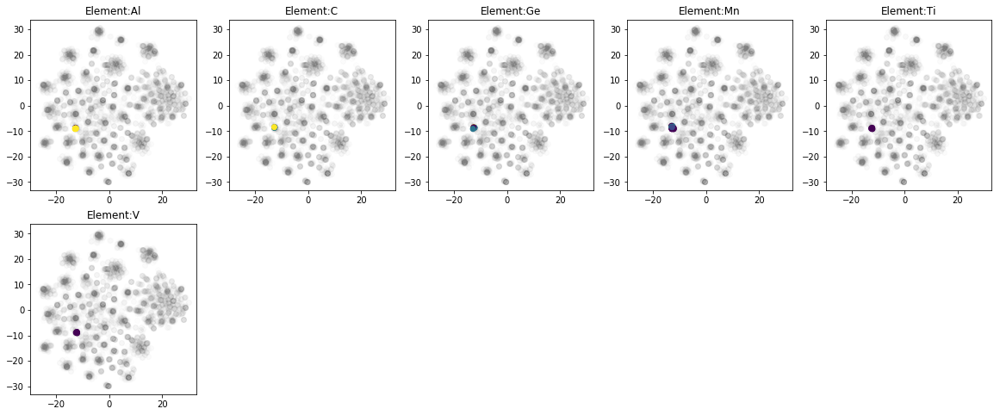

Cluster: 36
36 : Ba(0.240) O(0.585)


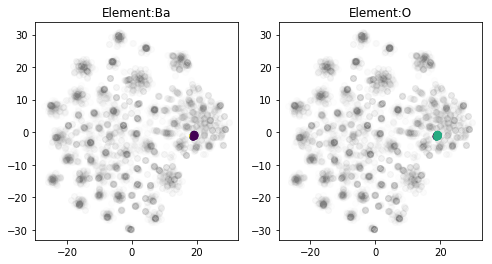

Cluster: 37
37 : N(0.027) Sn(0.041) Ti(0.729)


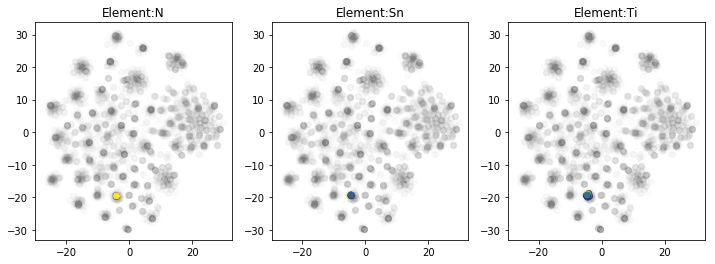

Cluster: 38
38 : B(0.027) C(0.065) In(0.073) Mg(0.028) Sc(0.613) Sn(0.026) Te(0.030) Tl(0.030)


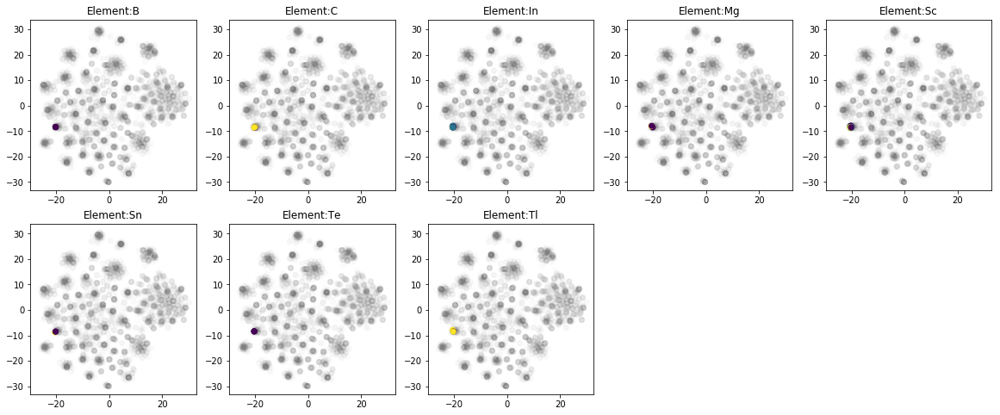

Cluster: 39
39 : Be(0.801)


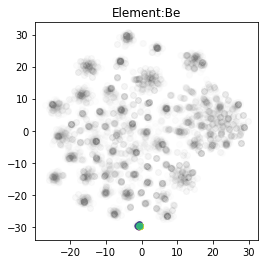

Cluster: 40
40 : O(0.653) V(0.231)


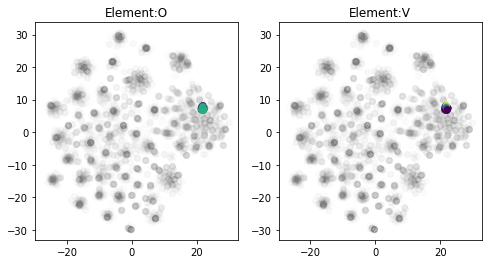

Cluster: 41
41 : In(0.638) Pt(0.042) Sr(0.040) Zr(0.032)


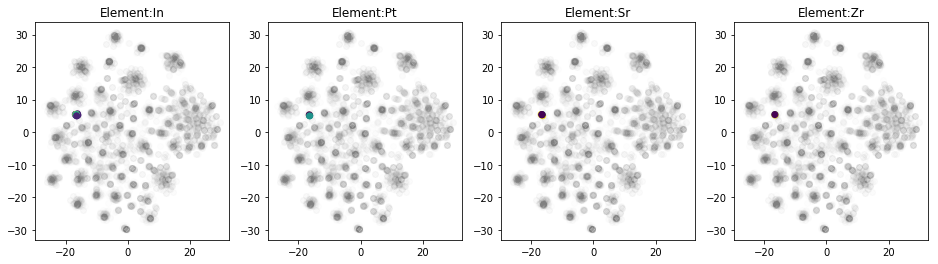

Cluster: 42
42 : Al(0.052) C(0.041) Ir(0.054) Ru(0.047) Y(0.576) Zn(0.027)


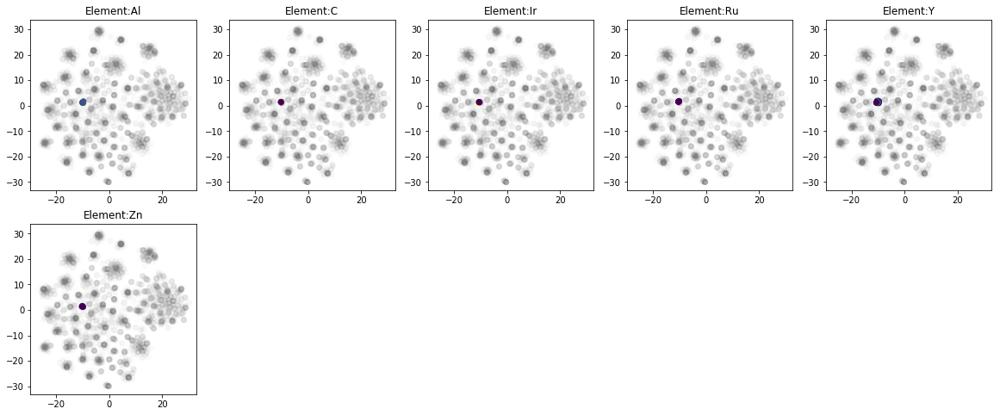

Cluster: 43
43 : F(0.643) Li(0.207) V(0.097)


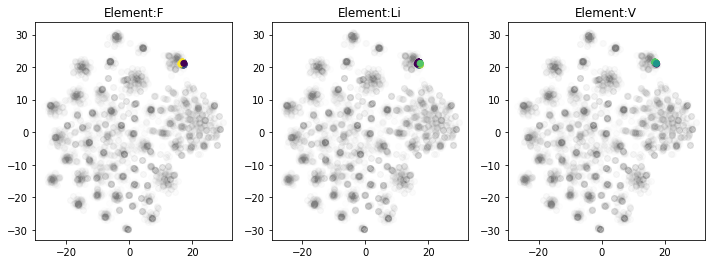

Cluster: 44
44 : C(0.042) Nb(0.683) Si(0.059)


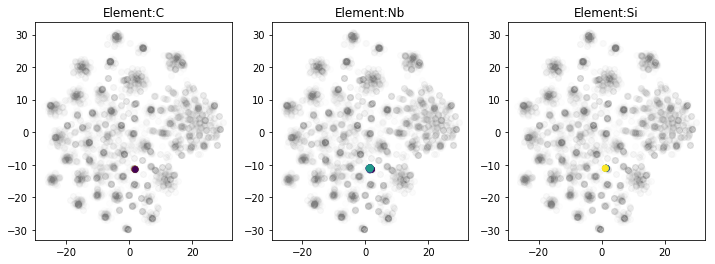

Cluster: 45
45 : Hf(0.583) Ir(0.038) Os(0.033) Re(0.027)


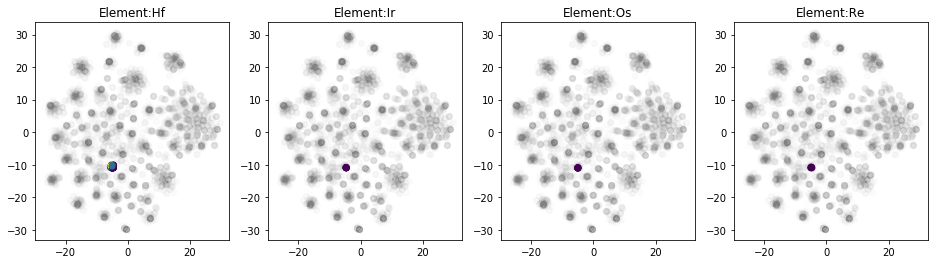

Cluster: 46
46 : Li(0.407) O(0.452)


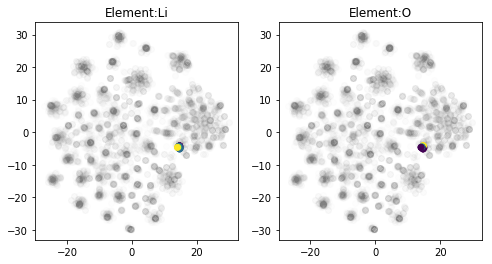

Cluster: 47
47 : C(0.775) Ca(0.043) Os(0.032)


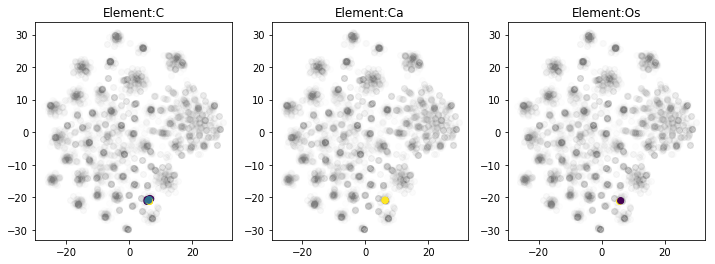

Cluster: 48
48 : Rh(0.667) Y(0.032) Zn(0.027)


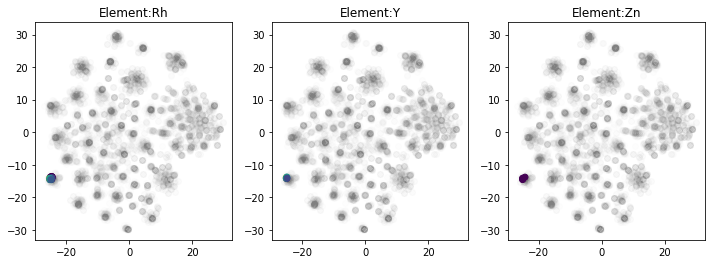

Cluster: 49
49 : Co(0.738) Ta(0.047) W(0.025)


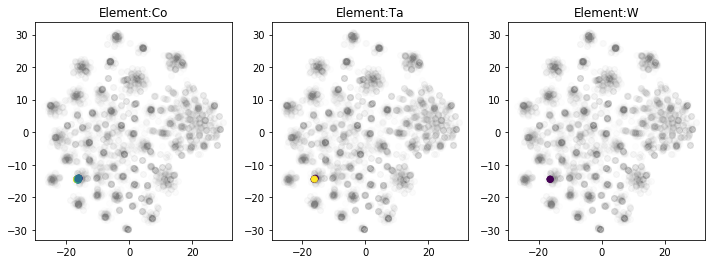

Cluster: 50
50 : Cu(0.320) Se(0.502)


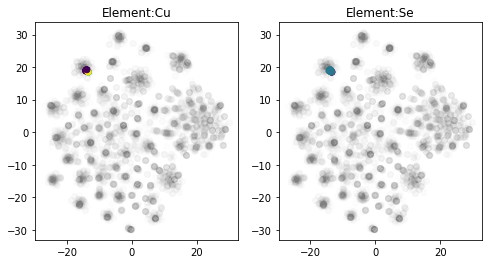

Cluster: 51
51 : O(0.700) W(0.208)


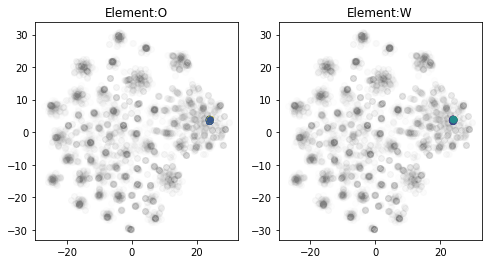

Cluster: 52
52 : O(0.644) Si(0.277)


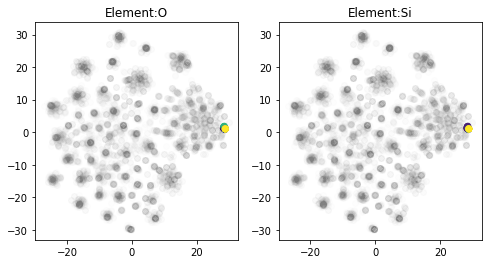

Cluster: 53
53 : Al(0.044) Cr(0.035) In(0.026) Te(0.664)


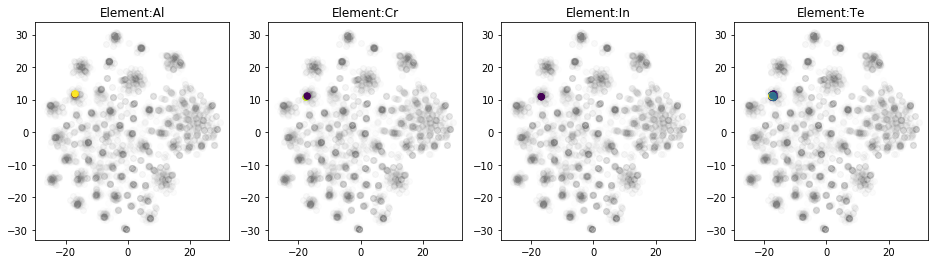

Cluster: 54
54 : Cl(0.623) Co(0.027) Cs(0.143) Ni(0.033) Ti(0.030) Tl(0.027)


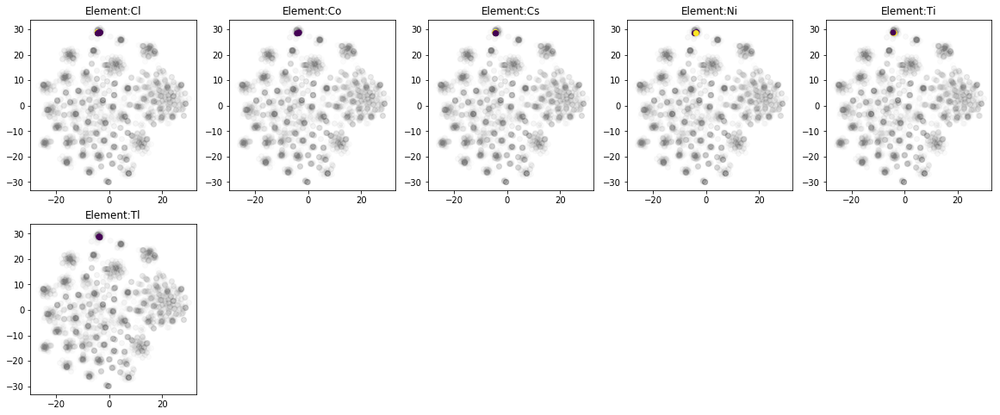

Cluster: 55
55 : C(0.050) Cr(0.668) N(0.025) Ti(0.032)


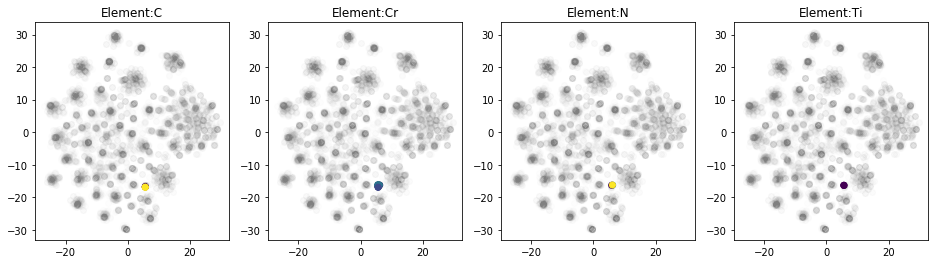

Cluster: 56
56 : N(0.446) Sr(0.374)


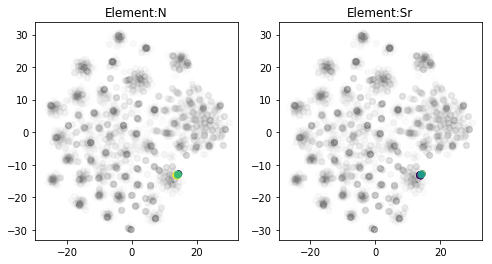

In [144]:
for lab in np.unique(labels):
    print("Cluster:",lab)
    label_mask = labels==lab
    cluster_mean_composition=cluster_mean_elements.loc[lab]
    cluster_mean_composition=cluster_mean_composition[cluster_mean_composition>0]
    ave_comp_str=" ".join(["%s(%.3f)"%(k,v) for k, v in cluster_mean_composition.to_dict().items()])
    print(lab,":", ave_comp_str)

    n_comp=len(cluster_mean_composition)
    if n_comp>=ncol_max:
        ncol = ncol_max
        nrow=n_comp//ncol + (1 if n_comp%ncol>0 else 0)
    else:
        nrow=1
        ncol=n_comp

    plt.figure(figsize=(ncol*fig_size,nrow*fig_size))
    for i,p in enumerate(cluster_mean_composition.index):
        ax=plt.subplot(nrow,ncol,i+1)
        element_mask = df[p]>0 
        cur_mask=(element_mask & label_mask)
        ax.scatter(X_tr_tsne[~cur_mask,0], X_tr_tsne[~cur_mask,1],alpha=0.01,color="gray")
        ax.scatter(X_tr_tsne[cur_mask,0], X_tr_tsne[cur_mask,1],c=np.log1p(df.loc[cur_mask,p]))    
        ax.set_title("Element:"+p)
        #plt.colorbar(ax=m_ax)
    plt.show()